# Exploratieve Data Analyse (EDA) #1
In dit labo maken we een verkennende analyse van open data van Uber. Terloops maken we kennis met de [Pandas](https://pandas.pydata.org/) en [Plotly](https://plotly.com/graphing-libraries/) bibliotheken.

Bron: [Uber Data Analytics Dashboard](https://www.kaggle.com/datasets/yashdevladdha/uber-ride-analytics-dashboard/data)

In [1]:
import os

import kagglehub
import pandas as pd


In [2]:
# Download data from kaggle
path = kagglehub.dataset_download("yashdevladdha/uber-ride-analytics-dashboard")

# Load data into Pandas DataFrame
csv_file = os.path.join(path, "ncr_ride_bookings.csv")
df = pd.read_csv(csv_file)
print("✅ Data loaded successfully!")

✅ Data loaded successfully!


We hebben de data nu ingeladen als een _Pandas DafaFrame_ (denk: Excel sheet 🫣)

In [3]:
print(df.__class__.__name__)

DataFrame


We kunnen snel de eerste of laatste rijen van de DataFrame bekijken via `.head()` en `.tail`.

In [4]:
# Inspect first 5 rows
df.head()

,Date,Time,Booking ID,Booking Status,Customer ID,Vehicle Type,Pickup Location,Drop Location,Avg VTAT,Avg CTAT,...,Reason for cancelling by Customer,Cancelled Rides by Driver,Driver Cancellation Reason,Incomplete Rides,Incomplete Rides Reason,Booking Value,Ride Distance,Driver Ratings,Customer Rating,Payment Method
0,2024-03-23,12:29:38,"""CNR5884300""",No Driver Found,"""CID1982111""",eBike,Palam Vihar,Jhilmil,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2024-11-29,18:01:39,"""CNR1326809""",Incomplete,"""CID4604802""",Go Sedan,Shastri Nagar,Gurgaon Sector 56,4.9,14.0,...,NaN,NaN,NaN,1.0,Vehicle Breakdown,237.0,5.73,NaN,NaN,UPI
2,2024-08-23,08:56:10,"""CNR8494506""",Completed,"""CID9202816""",Auto,Khandsa,Malviya Nagar,13.4,25.8,...,NaN,NaN,NaN,NaN,NaN,627.0,13.58,4.9,4.9,Debit Card
3,2024-10-21,17:17:25,"""CNR8906825""",Completed,"""CID2610914""",Premier Sedan,Central Secretariat,Inderlok,13.1,28.5,...,NaN,NaN,NaN,NaN,NaN,416.0,34.02,4.6,5.0,UPI
4,2024-09-16,22:08:00,"""CNR1950162""",Completed,"""CID9933542""",Bike,Ghitorni Village,Khan Market,5.3,19.6,...,NaN,NaN,NaN,NaN,NaN,737.0,48.21,4.1,4.3,UPI


In [5]:
# Inspect last 2 rows
df.tail(2)

,Date,Time,Booking ID,Booking Status,Customer ID,Vehicle Type,Pickup Location,Drop Location,Avg VTAT,Avg CTAT,...,Reason for cancelling by Customer,Cancelled Rides by Driver,Driver Cancellation Reason,Incomplete Rides,Incomplete Rides Reason,Booking Value,Ride Distance,Driver Ratings,Customer Rating,Payment Method
149998,2024-10-05,07:53:34,"""CNR3030099""",Completed,"""CID9415487""",Auto,Ghaziabad,Saidulajab,6.9,39.6,...,NaN,NaN,NaN,NaN,NaN,333.0,45.54,4.1,3.7,UPI
149999,2024-03-10,15:38:03,"""CNR3447390""",Completed,"""CID4108667""",Premier Sedan,Ashok Park Main,Gurgaon Sector 29,3.5,33.7,...,NaN,NaN,NaN,NaN,NaN,806.0,21.19,4.6,4.9,Credit Card


We kunnen snel een idee krijgen van het aantal _rijen_ via `len()`

In [6]:
print(f"📈 Total rides: {len(df):,}")

📈 Total rides: 150,000


Zoals bij NumPy, is er ook een `.shape` methode, maar die genereert enkel 2 dimensionele tuples.

In [7]:
print(f"📊 Dataset shape: {df.shape}")
nrow, ncol = df.shape
print(f" - rows: {nrow:,}")
print(f" - columns: {ncol:,}")

📊 Dataset shape: (150000, 21)
 - rows: 150,000
 - columns: 21


Kolomnamen zijn beschikbaar als een speciaal `Index` object via `.columns`

In [8]:
df.columns

Index(['Date', 'Time', 'Booking ID', 'Booking Status', 'Customer ID',
       'Vehicle Type', 'Pickup Location', 'Drop Location', 'Avg VTAT',
       'Avg CTAT', 'Cancelled Rides by Customer',
       'Reason for cancelling by Customer', 'Cancelled Rides by Driver',
       'Driver Cancellation Reason', 'Incomplete Rides',
       'Incomplete Rides Reason', 'Booking Value', 'Ride Distance',
       'Driver Ratings', 'Customer Rating', 'Payment Method'],
      dtype='object')

De `.info()` methode geeft een nuttig overzicht van de kolommen en data types.    
Merk op dat er voor sommige variabelen ontbrekende (niet-geregistreerde) waarden zijn (zogeheten **missing values**; zie `Non-Null Count < 15000`; bv. `Customer Rating`).

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150000 entries, 0 to 149999
Data columns (total 21 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Date                               150000 non-null  object 
 1   Time                               150000 non-null  object 
 2   Booking ID                         150000 non-null  object 
 3   Booking Status                     150000 non-null  object 
 4   Customer ID                        150000 non-null  object 
 5   Vehicle Type                       150000 non-null  object 
 6   Pickup Location                    150000 non-null  object 
 7   Drop Location                      150000 non-null  object 
 8   Avg VTAT                           139500 non-null  float64
 9   Avg CTAT                           102000 non-null  float64
 10  Cancelled Rides by Customer        10500 non-null   float64
 11  Reason for cancelling by Customer  1050

Niet alle waarden zijn numeriek (bv. `Time`, `Vehicle Type`, `Pickup Location`)

In [10]:
df[["Time", "Vehicle Type", "Pickup Location", "Avg VTAT"]].head()

,Time,Vehicle Type,Pickup Location,Avg VTAT
0,12:29:38,eBike,Palam Vihar,NaN
1,18:01:39,Go Sedan,Shastri Nagar,4.9
2,08:56:10,Auto,Khandsa,13.4
3,17:17:25,Premier Sedan,Central Secretariat,13.1
4,22:08:00,Bike,Ghitorni Village,5.3


Via de `.describe()` methode krijgen we snel een overzicht van de centrale tendensen.

In [11]:
df.describe()

,Avg VTAT,Avg CTAT,Cancelled Rides by Customer,Cancelled Rides by Driver,Incomplete Rides,Booking Value,Ride Distance,Driver Ratings,Customer Rating
count,139500.000000,102000.000000,10500.0,27000.0,9000.0,102000.000000,102000.000000,93000.000000,93000.000000
mean,8.456352,29.149636,1.0,1.0,1.0,508.295912,24.637012,4.230992,4.404584
std,3.773564,8.902577,0.0,0.0,0.0,395.805774,14.002138,0.436871,0.437819
min,2.000000,10.000000,1.0,1.0,1.0,50.000000,1.000000,3.000000,3.000000
25%,5.300000,21.600000,1.0,1.0,1.0,234.000000,12.460000,4.100000,4.200000
50%,8.300000,28.800000,1.0,1.0,1.0,414.000000,23.720000,4.300000,4.500000
75%,11.300000,36.800000,1.0,1.0,1.0,689.000000,36.820000,4.600000,4.800000
max,20.000000,45.000000,1.0,1.0,1.0,4277.000000,50.000000,5.000000,5.000000


Zoals in NumPy kunnen we een simpele _transpose_ aanroepen.

In [12]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Avg VTAT,139500.0,8.456352,3.773564,2.0,5.30,8.30,11.30,20.0
Avg CTAT,102000.0,29.149636,8.902577,10.0,21.60,28.80,36.80,45.0
Cancelled Rides by Customer,10500.0,1.000000,0.000000,1.0,1.00,1.00,1.00,1.0
Cancelled Rides by Driver,27000.0,1.000000,0.000000,1.0,1.00,1.00,1.00,1.0
Incomplete Rides,9000.0,1.000000,0.000000,1.0,1.00,1.00,1.00,1.0
Booking Value,102000.0,508.295912,395.805774,50.0,234.00,414.00,689.00,4277.0
Ride Distance,102000.0,24.637012,14.002138,1.0,12.46,23.72,36.82,50.0
Driver Ratings,93000.0,4.230992,0.436871,3.0,4.10,4.30,4.60,5.0
Customer Rating,93000.0,4.404584,0.437819,3.0,4.20,4.50,4.80,5.0


Iedere kolom kan apart als een `Series` object aangeroepen worden.

In [13]:
df.Time

0         12:29:38
1         18:01:39
2         08:56:10
3         17:17:25
4         22:08:00
            ...   
149995    19:34:01
149996    15:55:09
149997    10:55:15
149998    07:53:34
149999    15:38:03
Name: Time, Length: 150000, dtype: object

In [14]:
df.Time.__class__.__name__

'Series'

In [15]:
df["Booking Status"]

0         No Driver Found
1              Incomplete
2               Completed
3               Completed
4               Completed
               ...       
149995          Completed
149996          Completed
149997          Completed
149998          Completed
149999          Completed
Name: Booking Status, Length: 150000, dtype: object

Iedere `Series` is onderliggend een gewone NumPy array. Die kan je op elk moment oproepen via `.values`

In [16]:
df.Time.values

array(['12:29:38', '18:01:39', '08:56:10', ..., '10:55:15', '07:53:34',
       '15:38:03'], shape=(150000,), dtype=object)

In [17]:
df.Time.values.__class__.__name__

'ndarray'

Meer complexe indexering kan via `.loc` en `.iloc` syntax.

In [18]:
df["Vehicle Type"] == "Uber XL"

0         False
1         False
2         False
3         False
4         False
          ...  
149995    False
149996    False
149997    False
149998    False
149999    False
Name: Vehicle Type, Length: 150000, dtype: bool

In [19]:
df.loc[df["Vehicle Type"] == "Uber XL", ("Time", "Vehicle Type", "Pickup Location", "Avg VTAT")]

,Time,Vehicle Type,Pickup Location,Avg VTAT
25,06:34:38,Uber XL,Okhla,5.1
57,15:43:34,Uber XL,Anand Vihar ISBT,NaN
97,17:39:58,Uber XL,Madipur,NaN
113,18:46:34,Uber XL,Kherki Daula Toll,3.2
164,06:04:30,Uber XL,Kashmere Gate,6.9
...,...,...,...,...
149804,16:16:31,Uber XL,Kashmere Gate ISBT,13.3
149825,22:56:39,Uber XL,Lal Quila,12.6
149860,20:30:24,Uber XL,Samaypur Badli,NaN
149891,21:09:25,Uber XL,Kirti Nagar,3.2


In [20]:
(
    df.loc[
        df["Vehicle Type"] == "Uber XL", ("Time", "Vehicle Type", "Pickup Location", "Avg VTAT")
    ].reset_index(drop=True)
)

,Time,Vehicle Type,Pickup Location,Avg VTAT
0,06:34:38,Uber XL,Okhla,5.1
1,15:43:34,Uber XL,Anand Vihar ISBT,NaN
2,17:39:58,Uber XL,Madipur,NaN
3,18:46:34,Uber XL,Kherki Daula Toll,3.2
4,06:04:30,Uber XL,Kashmere Gate,6.9
...,...,...,...,...
4444,16:16:31,Uber XL,Kashmere Gate ISBT,13.3
4445,22:56:39,Uber XL,Lal Quila,12.6
4446,20:30:24,Uber XL,Samaypur Badli,NaN
4447,21:09:25,Uber XL,Kirti Nagar,3.2


In [21]:
df.loc[
    (df["Vehicle Type"] == "Uber XL")
    | (df["Vehicle Type"] == "Bike"),  # or df["Vehicle Type"].isin(["Uber XL", "Bike"])
    ("Time", "Vehicle Type", "Pickup Location", "Avg VTAT"),
]

,Time,Vehicle Type,Pickup Location,Avg VTAT
4,22:08:00,Bike,Ghitorni Village,5.3
25,06:34:38,Uber XL,Okhla,5.1
28,18:57:12,Bike,Shastri Park,3.1
39,13:02:42,Bike,Noida Extension,11.0
47,13:10:50,Bike,Dilshad Garden,2.3
...,...,...,...,...
149967,12:52:57,Bike,Khan Market,3.5
149972,16:00:00,Uber XL,Old Gurgaon,14.5
149975,08:07:31,Bike,Pataudi Chowk,13.0
149985,16:45:21,Bike,AIIMS,13.4


In [22]:
df.iloc[100:105, [0, 1, 3, 5]]

,Date,Time,Booking Status,Vehicle Type
100,2024-06-24,18:04:39,Completed,Go Mini
101,2024-03-28,19:20:01,Cancelled by Driver,Bike
102,2024-09-27,20:16:53,Completed,eBike
103,2024-04-26,15:45:51,Completed,Bike
104,2024-05-19,18:47:16,Completed,Bike


We kunnen op verschillende manieren data _aggregeren_. Zie [documentatie](https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.agg.html) voor meer info.

In [23]:
df.agg({"Time": ["min", "max"], "Avg VTAT": ["min", "max", "mean"]})

,Time,Avg VTAT
min,00:00:00,2.000000
max,23:59:59,20.000000
mean,NaN,8.456352


Het resultaat is telkens terug een `DataFrame` of `Series`.

In [24]:
# An indexed series of missing value counts
na_counts = df.isnull().sum()
na_counts

Date                                      0
Time                                      0
Booking ID                                0
Booking Status                            0
Customer ID                               0
Vehicle Type                              0
Pickup Location                           0
Drop Location                             0
Avg VTAT                              10500
Avg CTAT                              48000
Cancelled Rides by Customer          139500
Reason for cancelling by Customer    139500
Cancelled Rides by Driver            123000
Driver Cancellation Reason           123000
Incomplete Rides                     141000
Incomplete Rides Reason              141000
Booking Value                         48000
Ride Distance                         48000
Driver Ratings                        57000
Customer Rating                       57000
Payment Method                        48000
dtype: int64

In [25]:
na_counts.__class__.__name__

'Series'

In [26]:
na_counts.index

Index(['Date', 'Time', 'Booking ID', 'Booking Status', 'Customer ID',
       'Vehicle Type', 'Pickup Location', 'Drop Location', 'Avg VTAT',
       'Avg CTAT', 'Cancelled Rides by Customer',
       'Reason for cancelling by Customer', 'Cancelled Rides by Driver',
       'Driver Cancellation Reason', 'Incomplete Rides',
       'Incomplete Rides Reason', 'Booking Value', 'Ride Distance',
       'Driver Ratings', 'Customer Rating', 'Payment Method'],
      dtype='object')

In [27]:
na_counts["Customer Rating"]

np.int64(57000)

We kunnen gebruik maken van ingebouwde visualisatiemogelijkheden...

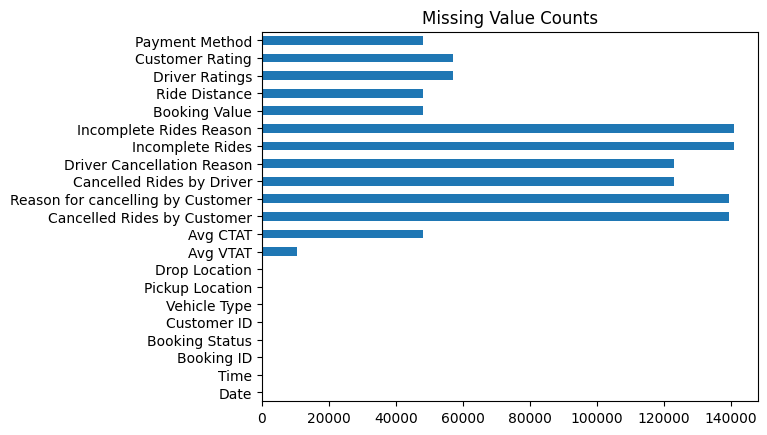

In [28]:
fig = na_counts.plot(kind="barh", title="Missing Value Counts")

of onze eigen (rijkere) visualisaties maken met Plotly voor exploratieve data analyse (EDA).

In [29]:
import plotly.express as px

In [30]:
fig = px.bar(na_counts, title="Missing Value Counts")
fig.show()

In [31]:
# Number of rides per vehicle type with different colors per type
fig = px.bar(
    df["Vehicle Type"].value_counts(),
    title="Number of Rides per Vehicle Type",
    color=df["Vehicle Type"].value_counts().index,
)
fig.show()

In [32]:
# Driver Ratings histogram
fig = px.histogram(df, x="Driver Ratings", nbins=20, title="Driver Ratings Histogram")
fig.show()

Analyse van _Avg CTAT_: _Average trip duration from pickup to destination (in minutes)_

In [33]:
fig = px.scatter(df, x="Time", y="Avg CTAT", color="Vehicle Type", title="Avg VTAT over Time")
fig.show()

Dit is duidelijk niet zo informatief ... wat missen we?
1. Eenduidige _timestamps_ (datum + tijd)

In [34]:
df.head()

,Date,Time,Booking ID,Booking Status,Customer ID,Vehicle Type,Pickup Location,Drop Location,Avg VTAT,Avg CTAT,...,Reason for cancelling by Customer,Cancelled Rides by Driver,Driver Cancellation Reason,Incomplete Rides,Incomplete Rides Reason,Booking Value,Ride Distance,Driver Ratings,Customer Rating,Payment Method
0,2024-03-23,12:29:38,"""CNR5884300""",No Driver Found,"""CID1982111""",eBike,Palam Vihar,Jhilmil,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2024-11-29,18:01:39,"""CNR1326809""",Incomplete,"""CID4604802""",Go Sedan,Shastri Nagar,Gurgaon Sector 56,4.9,14.0,...,NaN,NaN,NaN,1.0,Vehicle Breakdown,237.0,5.73,NaN,NaN,UPI
2,2024-08-23,08:56:10,"""CNR8494506""",Completed,"""CID9202816""",Auto,Khandsa,Malviya Nagar,13.4,25.8,...,NaN,NaN,NaN,NaN,NaN,627.0,13.58,4.9,4.9,Debit Card
3,2024-10-21,17:17:25,"""CNR8906825""",Completed,"""CID2610914""",Premier Sedan,Central Secretariat,Inderlok,13.1,28.5,...,NaN,NaN,NaN,NaN,NaN,416.0,34.02,4.6,5.0,UPI
4,2024-09-16,22:08:00,"""CNR1950162""",Completed,"""CID9933542""",Bike,Ghitorni Village,Khan Market,5.3,19.6,...,NaN,NaN,NaN,NaN,NaN,737.0,48.21,4.1,4.3,UPI


In [35]:
df["Date"].astype(str) + " " + df["Time"].astype(str)

0         2024-03-23 12:29:38
1         2024-11-29 18:01:39
2         2024-08-23 08:56:10
3         2024-10-21 17:17:25
4         2024-09-16 22:08:00
                 ...         
149995    2024-11-11 19:34:01
149996    2024-11-24 15:55:09
149997    2024-09-18 10:55:15
149998    2024-10-05 07:53:34
149999    2024-03-10 15:38:03
Length: 150000, dtype: object

In [36]:
# New date time column
df["DateTime"] = pd.to_datetime(df["Date"].astype(str) + " " + df["Time"].astype(str))

df["DateTime"].head()

0   2024-03-23 12:29:38
1   2024-11-29 18:01:39
2   2024-08-23 08:56:10
3   2024-10-21 17:17:25
4   2024-09-16 22:08:00
Name: DateTime, dtype: datetime64[ns]

In [37]:
fig = px.scatter(df, x="DateTime", y="Avg CTAT", color="Vehicle Type", title="Avg VTAT over Time")
fig.show()

2. _Resampling_ en aggregatie per uur

In [38]:
avg_ctat_hourly = (
    df.loc[:, ["DateTime", "Avg CTAT", "Vehicle Type"]]  # select only relevant columns
    .set_index("DateTime")  # set datetime as index (needed to allow resampling)
    .resample("h")  # resample to hourly frequency
    # aggregate by mean for each hour and vehicle type
    .agg({"Avg CTAT": "mean", "Vehicle Type": "first"})
    .reset_index()  # reset index to get datetime back as a column
    .dropna()  # drop missing values
)

avg_ctat_hourly

,DateTime,Avg CTAT,Vehicle Type
0,2024-01-01 00:00:00,38.900000,Bike
1,2024-01-01 01:00:00,28.850000,Go Mini
3,2024-01-01 03:00:00,33.800000,Go Sedan
4,2024-01-01 04:00:00,28.366667,eBike
5,2024-01-01 05:00:00,31.366667,Auto
...,...,...,...
8755,2024-12-30 19:00:00,31.126316,Go Mini
8756,2024-12-30 20:00:00,26.875000,Premier Sedan
8757,2024-12-30 21:00:00,26.457143,Go Mini
8758,2024-12-30 22:00:00,24.130000,Premier Sedan


In [39]:
fig = px.line(
    avg_ctat_hourly, x="DateTime", y="Avg CTAT", color="Vehicle Type", title="Avg CTAT over Time"
)
fig.show()

3. _Subplots_ en _smoothing_

In [40]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from statsmodels.nonparametric.smoothers_lowess import lowess

In [41]:
vehicle_types = df["Vehicle Type"].unique()

fig = make_subplots(rows=len(vehicle_types), cols=1)

for i, vehicle_type in enumerate(vehicle_types, start=1):
    x = avg_ctat_hourly.loc[avg_ctat_hourly["Vehicle Type"] == vehicle_type, "DateTime"]
    y = avg_ctat_hourly.loc[avg_ctat_hourly["Vehicle Type"] == vehicle_type, "Avg CTAT"]

    # Scatter
    fig.add_trace(go.Scatter(x=x, y=y, name=vehicle_type, mode="lines"), row=i, col=1)

    # LOWESS smoothing
    lowess_result = lowess(y, x, frac=0.02)  # frac controls smoothing
    lowess_x = lowess_result[:, 0]
    lowess_y = lowess_result[:, 1]
    fig.add_trace(
        go.Scatter(
            x=x, y=lowess_y, name=f"{vehicle_type} (LOWESS)", mode="lines", showlegend=False
        ),
        row=i,
        col=1,
    )

fig.update_layout(height=300 * len(vehicle_types), title_text="Avg CTAT over Time by Vehicle Type")

fig.show()

4. Aggregatie per uur van de dag

In [42]:
df["Hour"] = df["DateTime"].dt.hour
df_agg_hourly = (
    df.groupby(["Hour", "Vehicle Type"])["Avg CTAT"]  # group by hour and vehicle type
    .mean()  # aggregate by mean
    .reset_index()  # reset index to get hour and vehicle type back as columns
)

df_agg_hourly.head()

,Hour,Vehicle Type,Avg CTAT
0,0,Auto,29.113699
1,0,Bike,28.918243
2,0,Go Mini,29.377073
3,0,Go Sedan,29.695541
4,0,Premier Sedan,28.627500


In [43]:
fig = px.line(
    df_agg_hourly, x="Hour", y="Avg CTAT", color="Vehicle Type", title="Avg CTAT by Hour of Day"
)
fig.show()

In [44]:
# box plot for Premier Sedans per hour of the day
fig = px.box(
    df.loc[df["Vehicle Type"] == "Premier Sedan", :],
    x="Hour",
    y="Avg CTAT",
    title="Avg CTAT Distribution for Premier Sedans by Hour of Day",
)
fig.show()

Idem, maar per dag van de week.

In [45]:
# Day of the week
df["DayOfWeek"] = df["DateTime"].dt.day_name()

fig = px.box(
    df.loc[df["Vehicle Type"] == "Premier Sedan", :],
    x="DayOfWeek",
    y="Avg CTAT",
    title="Avg CTAT Distribution for Premier Sedans by Day of Week",
)
fig.show()

We bekijken de verdeling van de _Booking Status_

In [46]:
# Helper function to categorize booking status
def categorize_status(status):
    """Categorize booking status into Completed, Cancelled, No Driver Found, Other."""
    if status == "Completed":
        return "Completed"
    if "Cancelled" in str(status):
        return "Cancelled"
    if status == "No Driver Found":
        return "No Driver Found"
    return "Other"

In [47]:
# Create new status variable using .apply
df["Status_Category"] = df["Booking Status"].apply(categorize_status)

In [48]:
fig = px.pie(df, names="Status_Category", title="Booking Status Distribution")
fig.show()

Per type voertuig

In [49]:
# Booking status by vehicle type
df_booking_status = df.groupby(["Vehicle Type", "Booking Status"]).size().reset_index(name="Count")

fig = px.bar(
    df_booking_status,
    x="Vehicle Type",
    y="Count",
    barmode="group",
    title="Number of Rides per Vehicle Type",
    color="Booking Status",
)
fig.show()

Correlaties

In [50]:
# Correlations between numerical variables
df_num = df.loc[
    :,
    ("Avg VTAT", "Avg CTAT", "Booking Value", "Ride Distance", "Driver Ratings", "Customer Rating"),
]
df_num.dropna(inplace=True)  # drop rows with missing values

df_num.corr()

,Avg VTAT,Avg CTAT,Booking Value,Ride Distance,Driver Ratings,Customer Rating
Avg VTAT,1.000000,0.001501,0.002823,0.003858,-0.005439,-0.003945
Avg CTAT,0.001501,1.000000,0.000740,0.001486,0.000807,0.001000
Booking Value,0.002823,0.000740,1.000000,0.005668,-0.000249,-0.000287
Ride Distance,0.003858,0.001486,0.005668,1.000000,-0.001875,0.004514
Driver Ratings,-0.005439,0.000807,-0.000249,-0.001875,1.000000,-0.001010
Customer Rating,-0.003945,0.001000,-0.000287,0.004514,-0.001010,1.000000


In [51]:
# Box plot with booking value per vehicle type
fig = px.box(
    df,
    x="Vehicle Type",
    y="Booking Value",
    title="Booking Value Distribution per Vehicle Type",
    log_y=True,
)
fig.show()